In [1]:
import os, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import requests

from agreement.utils.transform import pivot_table_frequency
from agreement.utils.kernels import linear_kernel
from agreement.metrics import cohens_kappa, krippendorffs_alpha, gwets_gamma, scotts_pi

In [2]:
df = pd.concat([
    pd.read_csv('output/cc3m-val.csv'),
    pd.read_csv('output/cc3m-trn.csv')
])

In [3]:
df['grouped_match_score'] = df['match_score'].apply(lambda x: 0.56 if int((x+0.005)*100) / 100 > 0.56 else int((x+0.005)*100) / 100 )

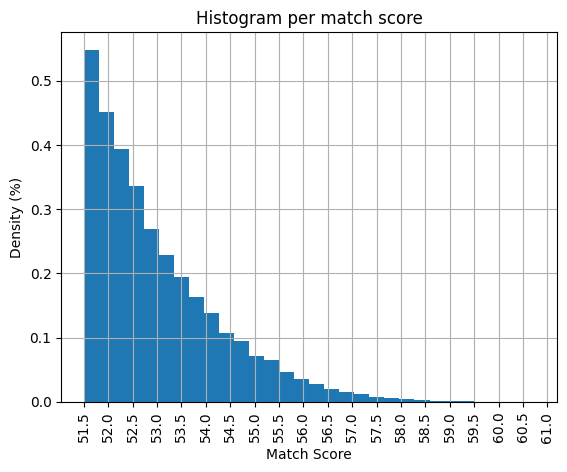

In [4]:
ax = (df['match_score'] * 100).hist(bins=30, density=True)
plt.ylabel('Density (%)')
plt.xlabel('Match Score')
plt.xticks(np.arange(51.5,61.5,0.5), rotation=90)
plt.title('Histogram per match score')
plt.show()

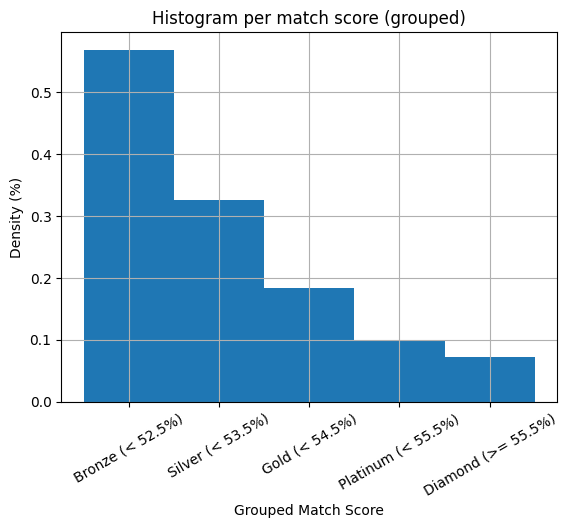

In [9]:
ax = (df['grouped_match_score'] * 100).hist(bins=5, density=True)
plt.ylabel('Density (%)')
plt.xlabel('Grouped Match Score')
plt.xticks(np.arange(52.4,56,0.8), ['Bronze (< 52.5%)', 'Silver (< 53.5%)', 'Gold (< 54.5%)', 'Platinum (< 55.5%)', 'Diamond (>= 55.5%)'], rotation=30)
plt.title('Histogram per match score (grouped)')
plt.show()

In [8]:
score_map = {0.52: 'Bronze (< 52.5%)', 0.53: 'Silver (< 53.5%)', 0.54: 'Gold (< 54.5%)', 0.55: 'Platinum (< 55.5%)', 0.56: 'Diamond (>= 55.5%)'}
df['group_name'] = df['grouped_match_score'].apply(lambda x: score_map[x])
cdf = df.groupby(['group_name', 'grouped_match_score']).size().to_frame('count').reset_index()
cdf['density'] = (cdf['count'] / cdf['count'].sum())
cdf.sort_values('grouped_match_score')[['group_name', 'count', 'density']]

,group_name,count,density
0,Bronze (< 52.5%),11885,0.454667
4,Silver (< 53.5%),6824,0.261056
2,Gold (< 54.5%),3841,0.146940
3,Platinum (< 55.5%),2091,0.079992
1,Diamond (>= 55.5%),1499,0.057345


In [7]:
df['category'].unique()

array(['Geography / buildings / landmarks', 'People and everyday life',
       'Cooking and food', 'Traditions / art / history',
       'Objects / materials / clothing', 'Plants and animal',
       'Sports and recreation', 'Vehicles and Transportation',
       'Brands / products / companies', 'Public Figure and pop culture'],
      dtype=object)

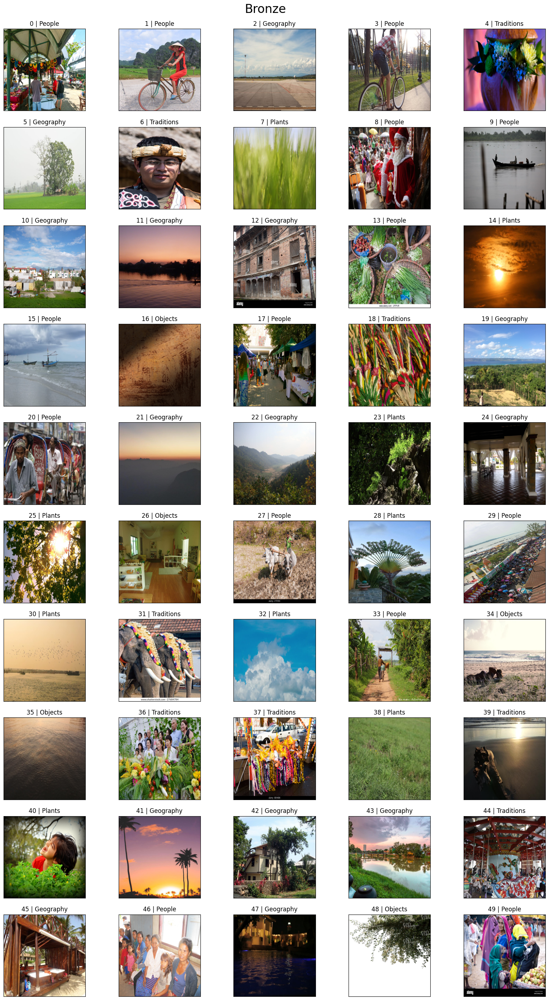

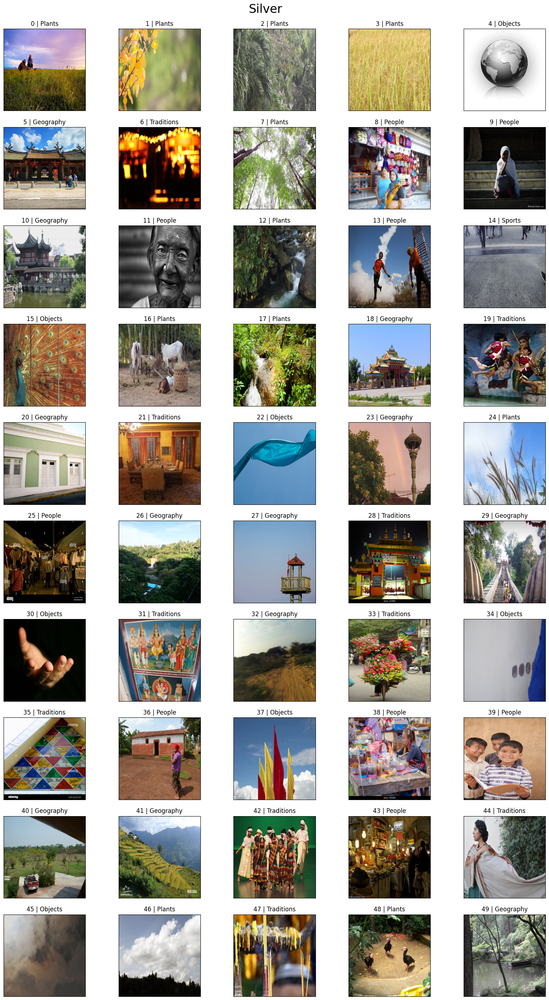

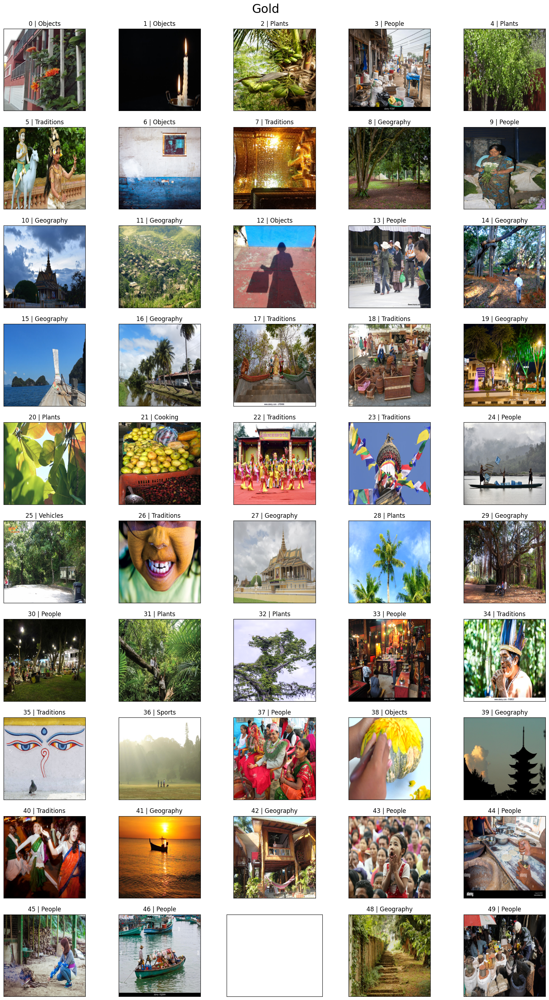

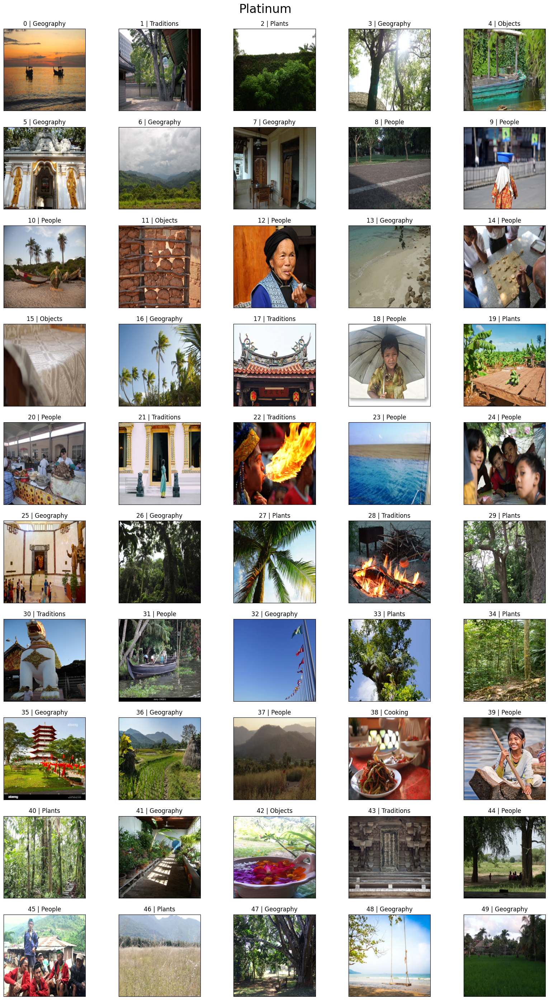

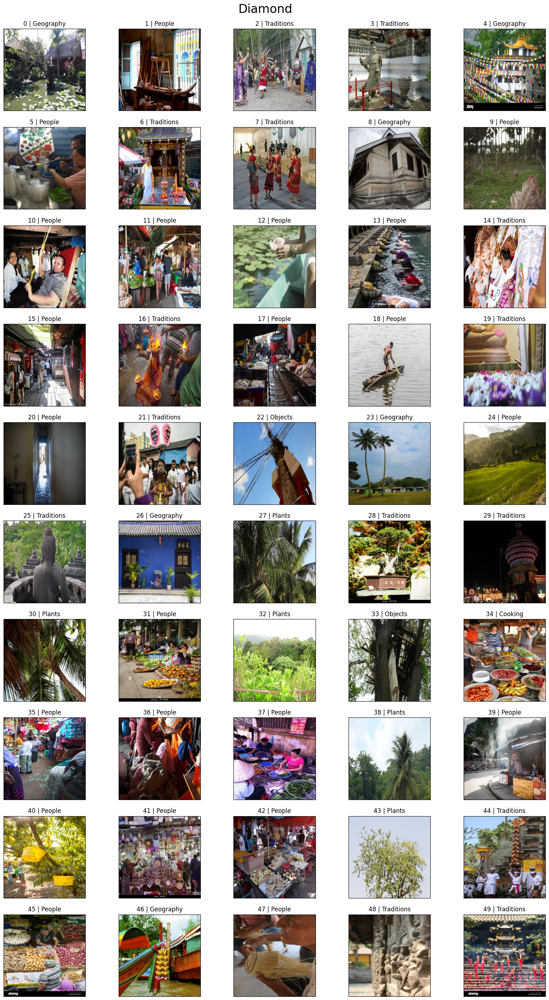

In [8]:
score_map = {0.52: 'Bronze', 0.53: 'Silver', 0.54: 'Gold', 0.55: 'Platinum', 0.56: 'Diamond'}

for score, gdf in df.groupby('grouped_match_score'):
    sdf = gdf.sample(50, random_state=42)
    image_urls = sdf['img_url']
    categories = sdf['category']
    
    # Create a 5x10 subplot grid
    fig, axs = plt.subplots(10, 5, figsize=(20, 35))
    fig.suptitle(f'{score_map[score]}', fontsize=24, y=0.9)

    # Iterate over the image paths and custom titles
    for i, (image_url, category) in enumerate(zip(image_urls, categories)):
        try:
            # Calculate the subplot indices
            row = i // 5
            col = i % 5

            # Plot the image in the corresponding subplot
            axs[row, col].imshow(Image.open(requests.get(image_url, stream=True).raw).resize((224, 224), Image.BICUBIC))
            axs[row, col].set_title(f"{i} | {category.strip().split(' ')[0]}")
            axs[row, col].axes.get_xaxis().set_ticks([])
            axs[row, col].axes.get_yaxis().set_ticks([])
        except:
            axs[row, col].axes.get_xaxis().set_ticks([])
            axs[row, col].axes.get_yaxis().set_ticks([])
            pass
    plt.savefig(f'{score_map[score]}-group.pdf', bbox_inches='tight')
    plt.show()

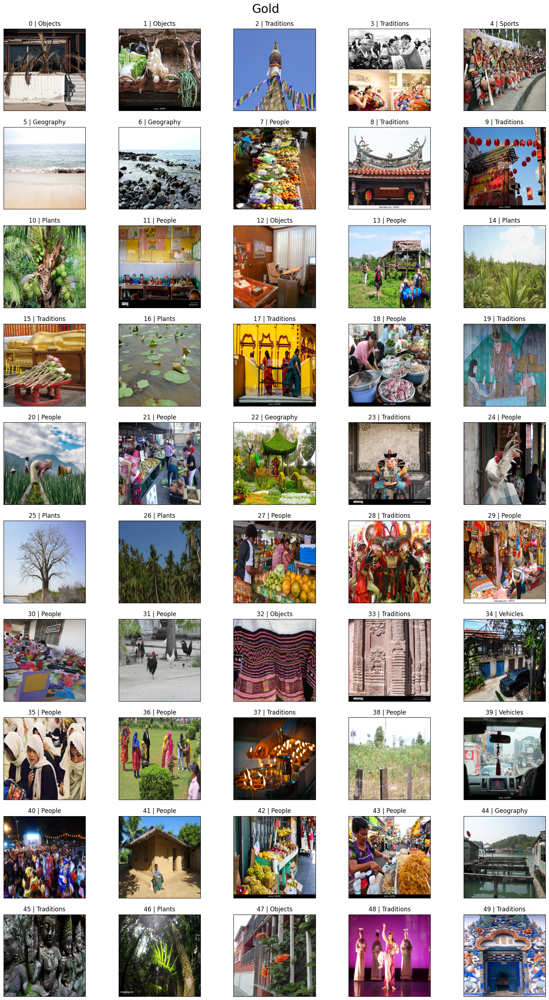

In [10]:
score_map = {0.52: 'Bronze', 0.53: 'Silver', 0.54: 'Gold', 0.55: 'Platinum', 0.56: 'Diamond'}

for score, gdf in df.groupby('grouped_match_score'):
    if score_map[score] == 'Gold':
        sdf = gdf.sample(50, random_state=14034)
        image_urls = sdf['img_url']
        categories = sdf['category']

        # Create a 5x10 subplot grid
        fig, axs = plt.subplots(10, 5, figsize=(20, 35))
        fig.suptitle(f'{score_map[score]}', fontsize=24, y=0.9)

        # Iterate over the image paths and custom titles
        for i, (image_url, category) in enumerate(zip(image_urls, categories)):
            try:
                # Calculate the subplot indices
                row = i // 5
                col = i % 5

                # Plot the image in the corresponding subplot
                axs[row, col].imshow(Image.open(requests.get(image_url, stream=True).raw).resize((224, 224), Image.BICUBIC))
                axs[row, col].set_title(f"{i} | {category.strip().split(' ')[0]}")
                axs[row, col].axes.get_xaxis().set_ticks([])
                axs[row, col].axes.get_yaxis().set_ticks([])
            except:
                axs[row, col].axes.get_xaxis().set_ticks([])
                axs[row, col].axes.get_yaxis().set_ticks([])
                pass
        plt.savefig(f'{score_map[score]}-group.pdf', bbox_inches='tight')
        plt.show()

# Recap Human Evaluation

In [11]:
recap_df = pd.read_csv('SEA Image Crawler Human Annotation - Recap Annotator.csv')

In [20]:
recap_df.loc[(recap_df['Answer'] == '1') & (recap_df['Question'] == 'SEA'),'Count'] / 50

2     0.44
5     0.76
8     0.84
11    0.86
14    0.92
Name: Count, dtype: float64

Text(0.5, 1.0, 'Is this image likely to be seen in SEA?')

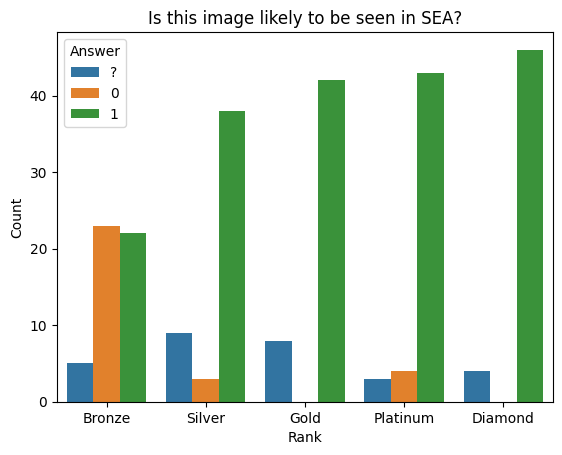

In [23]:
sea_df = recap_df.loc[recap_df['Question'] == 'SEA',:]
sns.barplot(x=sea_df['Rank'], y=sea_df['Count'], hue=sea_df['Answer'])
plt.title('Is this image likely to be seen in SEA?')

Text(0.5, 1.0, 'Does the category fit the image?')

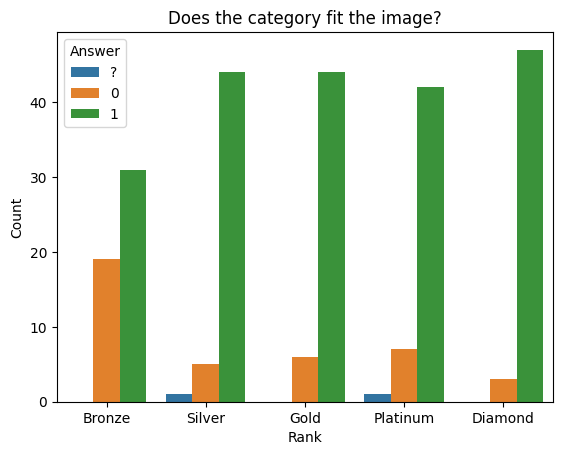

In [24]:
cat_df = recap_df.loc[recap_df['Question'] == 'Category',:]
sns.barplot(x=cat_df['Rank'], y=cat_df['Count'], hue=cat_df['Answer'])
plt.title('Does the category fit the image?')

# Multi Annotators

In [2]:
df = pd.read_csv('SEA Image Crawler Human Annotation - Combined.csv')

In [3]:
q1_df = df.melt(id_vars=['Threshold', 'Index'], value_vars=['H1', 'F1', 'P1'], var_name='Annot', value_name='Value')
q2_df = df.melt(id_vars=['Threshold', 'Index'], value_vars=['H2', 'F2', 'P2'], var_name='Annot', value_name='Value')

q1_df.loc[q1_df['Value'] == '?', 'Value'] = '0'
q2_df.loc[q2_df['Value'] == '?', 'Value'] = '0'

q1_df['QuestionID'] = q1_df.apply(lambda x: f"{x['Threshold']}-{x['Index']}", axis='columns')
q2_df['QuestionID'] = q2_df.apply(lambda x: f"{x['Threshold']}-{x['Index']}", axis='columns')

In [4]:
gdf = q1_df.groupby(['Threshold', 'Index'])['Value'].agg(pd.Series.mode).reset_index()
gdf.groupby(['Threshold','Value']).size().to_frame('Count').reset_index().pivot(index='Threshold', columns='Value', values='Count').reset_index()

Value,Threshold,0,1
0,Bronze,24,26
1,Diamond,7,43
2,Gold,15,35
3,Platinum,16,34
4,Silver,19,31


In [5]:
gdf = q2_df.groupby(['Threshold', 'Index'])['Value'].agg(pd.Series.mode).reset_index()
gdf.groupby(['Threshold','Value']).size().to_frame('Count').reset_index().pivot(index='Threshold', columns='Value', values='Count').reset_index()

Value,Threshold,0,1
0,Bronze,14,36
1,Diamond,11,39
2,Gold,10,40
3,Platinum,12,38
4,Silver,13,37


In [13]:
iaa_stats = {'threshold': [], 'alpha': [], 'kappa': [], 'weighted_kappa': [], 'gamma': [], 'pi': []}
questions_answers_table = pivot_table_frequency(q1_df.loc[:, 'QuestionID'], q1_df.loc[:, 'Value'])
users_answers_table = pivot_table_frequency(q1_df.loc[:, 'Annot'], q1_df.loc[:, 'Value'])

kappa = cohens_kappa(questions_answers_table, users_answers_table)
weighted_kappa = cohens_kappa(questions_answers_table, users_answers_table, weights_kernel=linear_kernel)
alpha = krippendorffs_alpha(questions_answers_table)
gamma = gwets_gamma(questions_answers_table)
pi = scotts_pi(questions_answers_table)

print(f'Overall | alpha: {alpha:.3f} | kappa: {kappa:.3f} | weighted_kappa: {weighted_kappa:.3f} | gamma: {gamma:.3f} | pi: {pi:.3f}')

iaa_stats['threshold'].append('Overall')
iaa_stats['alpha'].append(alpha)
iaa_stats['kappa'].append(kappa)
iaa_stats['weighted_kappa'].append(weighted_kappa)
iaa_stats['gamma'].append(gamma)
iaa_stats['pi'].append(pi)

for threshold, gdf in q1_df.groupby('Threshold'):
    questions_answers_table = pivot_table_frequency(gdf.loc[:, 'QuestionID'], gdf.loc[:, 'Value'])
    users_answers_table = pivot_table_frequency(gdf.loc[:, 'Annot'], gdf.loc[:, 'Value'])

    kappa = cohens_kappa(questions_answers_table, users_answers_table)
    weighted_kappa = cohens_kappa(questions_answers_table, users_answers_table, weights_kernel=linear_kernel)
    alpha = krippendorffs_alpha(questions_answers_table)
    gamma = gwets_gamma(questions_answers_table)
    pi = scotts_pi(questions_answers_table)

    print(f'{threshold} | alpha: {alpha:.3f} | kappa: {kappa:.3f} | weighted_kappa: {weighted_kappa:.3f}| gamma: {gamma:.3f} | pi: {pi:.3f}')
    
    iaa_stats['threshold'].append(threshold)
    iaa_stats['alpha'].append(alpha)
    iaa_stats['kappa'].append(kappa)
    iaa_stats['weighted_kappa'].append(weighted_kappa)
    iaa_stats['gamma'].append(gamma)
    iaa_stats['pi'].append(pi)    
iaa_df = pd.DataFrame(iaa_stats)
iaa_df.to_csv('q1_iaa.csv', index=False)

Overall | alpha: 0.150 | kappa: 0.217 | weighted_kappa: 0.217 | gamma: 0.245 | pi: 0.149
Bronze | alpha: 0.072 | kappa: 0.179 | weighted_kappa: 0.179| gamma: 0.067 | pi: 0.066
Diamond | alpha: 0.258 | kappa: 0.273 | weighted_kappa: 0.273| gamma: 0.674 | pi: 0.254
Gold | alpha: 0.057 | kappa: 0.119 | weighted_kappa: 0.119| gamma: 0.268 | pi: 0.050
Platinum | alpha: 0.149 | kappa: 0.217 | weighted_kappa: 0.217| gamma: 0.201 | pi: 0.143
Silver | alpha: 0.046 | kappa: 0.171 | weighted_kappa: 0.171| gamma: 0.041 | pi: 0.039


,threshold,alpha,kappa,weighted_kappa,gamma,pi
0,Overall,0.149901,0.217348,0.217348,0.245417,0.148766
1,Bronze,0.072229,0.178789,0.178789,0.067330,0.066002
2,Diamond,0.258489,0.272883,0.272883,0.674496,0.253513
3,Gold,0.056577,0.118818,0.118818,0.268178,0.050245
4,Platinum,0.149199,0.217172,0.217172,0.201168,0.143489
5,Silver,0.045721,0.170507,0.170507,0.040682,0.039317


In [9]:
iaa_stats = {'threshold': [], 'alpha': [], 'kappa': [], 'weighted_kappa': [], 'gamma': [], 'pi': []}
questions_answers_table = pivot_table_frequency(q2_df.loc[:, 'QuestionID'], q2_df.loc[:, 'Value'])
users_answers_table = pivot_table_frequency(q2_df.loc[:, 'Annot'], q2_df.loc[:, 'Value'])

kappa = cohens_kappa(questions_answers_table, users_answers_table)
weighted_kappa = cohens_kappa(questions_answers_table, users_answers_table, weights_kernel=linear_kernel)
alpha = krippendorffs_alpha(questions_answers_table)
gamma = gwets_gamma(questions_answers_table)
pi = scotts_pi(questions_answers_table)

print(f'Overall | alpha: {alpha:.3f} | kappa: {kappa:.3f} | weighted_kappa: {weighted_kappa:.3f} | gamma: {gamma:.3f} | pi: {pi:.3f}')

iaa_stats['threshold'].append('Overall')
iaa_stats['alpha'].append(alpha)
iaa_stats['kappa'].append(kappa)
iaa_stats['weighted_kappa'].append(weighted_kappa)
iaa_stats['gamma'].append(gamma)
iaa_stats['pi'].append(pi)

for threshold, gdf in q2_df.groupby('Threshold'):
    questions_answers_table = pivot_table_frequency(gdf.loc[:, 'QuestionID'], gdf.loc[:, 'Value'])
    users_answers_table = pivot_table_frequency(gdf.loc[:, 'Annot'], gdf.loc[:, 'Value'])

    kappa = cohens_kappa(questions_answers_table, users_answers_table)
    weighted_kappa = cohens_kappa(questions_answers_table, users_answers_table, weights_kernel=linear_kernel)
    alpha = krippendorffs_alpha(questions_answers_table)
    gamma = gwets_gamma(questions_answers_table)
    pi = scotts_pi(questions_answers_table)

    print(f'{threshold} | alpha: {alpha:.3f} | kappa: {kappa:.3f} | weighted_kappa: {weighted_kappa:.3f}| gamma: {gamma:.3f} | pi: {pi:.3f}')
    
    iaa_stats['threshold'].append(threshold)
    iaa_stats['alpha'].append(alpha)
    iaa_stats['kappa'].append(kappa)
    iaa_stats['weighted_kappa'].append(weighted_kappa)
    iaa_stats['gamma'].append(gamma)
    iaa_stats['pi'].append(pi)    
iaa_df = pd.DataFrame(iaa_stats)
iaa_df.to_csv('q2_iaa.csv', index=False)

Overall | alpha: 0.526 | kappa: 0.528 | weighted_kappa: 0.528 | gamma: 0.700 | pi: 0.525
Bronze | alpha: 0.689 | kappa: 0.687 | weighted_kappa: 0.687| gamma: 0.768 | pi: 0.686
Diamond | alpha: 0.556 | kappa: 0.555 | weighted_kappa: 0.555| gamma: 0.751 | pi: 0.553
Gold | alpha: 0.323 | kappa: 0.325 | weighted_kappa: 0.325| gamma: 0.597 | pi: 0.318
Platinum | alpha: 0.419 | kappa: 0.431 | weighted_kappa: 0.431| gamma: 0.664 | pi: 0.415
Silver | alpha: 0.611 | kappa: 0.611 | weighted_kappa: 0.611| gamma: 0.729 | pi: 0.609
